In [2]:
import os
import importlib
import pandas as pd
import geopandas as gpd
import reprojection_source as rp
pd.set_option('display.max_columns', None)

In [12]:
importlib.reload(rp)

<module 'reprojection_source' from '/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py'>

In [4]:
# Dirección de los datos Raw
path_data_raw = "../../Sample_Data/Raw/"
path_data_processed = "../../Sample_Data/Processed/"
path_data_modeling= "../../Sample_Data/For_Modeling/"
malla_path = path_data_raw + "malla_geoestadistica/conjunto_de_datos/"

# Columnas a guardar
cols = ["CVEGEO", "POBTOT", "geometry"]

# Lugar a explorar
PLACES =[{"NOM_MUN": "Guadalajara",
         "CVE_ENT": "14",
         "CVE_MUN": "039"
         },
         {"NOM_MUN": "Mérida",
         "CVE_ENT": "31",
         "CVE_MUN": "050"
         },
         {"NOM_MUN": "Monterrey",
         "CVE_ENT": "19",
         "CVE_MUN": "039"
         },
         {"NOM_MUN": "Querétaro",
         "CVE_ENT": "22",
         "CVE_MUN": "014"
         },
         {"NOM_MUN": "Culiacán",
         "CVE_ENT": "25",
         "CVE_MUN": "006"
         },
         {"NOM_MUN": "Mazatlán",
         "CVE_ENT": "25",
         "CVE_MUN": "012"
         },
         {"NOM_MUN": "Hermosillo",
         "CVE_ENT": "25",
         "CVE_MUN": "012"
         }]
        

In [4]:
# Cargar datos del 2000
print("Cargando AGEBS y Censo del 2000")
agebs_2000_path = path_data_raw + "agebs_2000/NACIONAL/N_Agebs_0000_01.shp"
censo_2000 = rp.load_censo_2000(agebs_2000_path)
print("Completado")

Cargando AGEBS y Censo del 2000
Completado


In [5]:
print("Cargando AGEBS y Censo del 2010")
# Cargar datos del 2010
agebs_2010_path = path_data_raw + "agebs_2010/AGEB_urb_2010_5.shp"
censo_2010_path = path_data_raw + "censo_2010/"

agebs_2010 = rp.load_agebs_2010(agebs_2010_path)
censo_2010 = rp.load_censo_2010(censo_2010_path)
print("Completado")
print("Cargando AGEBS y Censo del 2020")
# Cargar datos del 2020
agebs_2020_path = path_data_raw + "agebs_2020/mg_2020_integrado/conjunto_de_datos/00a.shp"
censo_2020_path = path_data_raw + "censo_2020/"

agebs_2020 = rp.load_agebs_2020(agebs_2020_path)
censo_2020 = rp.load_censo_2020(censo_2020_path)
print("Completado")

Cargando AGEBS y Censo del 2010
Completado
Cargando AGEBS y Censo del 2020
Completado


In [5]:
mpios_metropoli_path = path_data_raw + "metropoli/mpios_en_metropoli.shp"
mpios_en_metropoli = rp.load_mpios_metropoli(mpios_metropoli_path)

In [7]:
for PLACE in PLACES:
    print("Filtrando datos de", PLACE["NOM_MUN"])
    zona_metropolitana = mpios_en_metropoli[mpios_en_metropoli.NOMGEO_COR == PLACE["NOM_MUN"]].copy()
    zona_metropolitana = zona_metropolitana[["CVE_ENT","CVE_MUN"]]
    print(zona_metropolitana)
    print("Filtrando Censo del 2000")
    censo_2000_filtered = rp.filter_censo_2000(censo_2000, zona_metropolitana, cols)
    print("Filtrando Censo del 2010")
    censo_2010_filtered = rp.filter_censo_2010(agebs_2010, censo_2010, zona_metropolitana, cols)
    print("Filtrando Censo del 2020")
    censo_2020_filtered = rp.filter_censo_2020(agebs_2020, censo_2020, zona_metropolitana, cols)

    print("Reproyectando al CRS del Censo del 2020")
    censo_2000_filtered = censo_2000_filtered.to_crs(censo_2020_filtered.crs)
    censo_2010_filtered = censo_2010_filtered.to_crs(censo_2020_filtered.crs)

    print("Guardando archivos")
    rp.save_censo(censo_2000_filtered, 2000, PLACE, path_data_processed)
    print("Censo 2000 guardado!")
    rp.save_censo(censo_2010_filtered, 2010, PLACE, path_data_processed)
    print("Censo 2010 guardado!")
    rp.save_censo(censo_2020_filtered, 2020, PLACE, path_data_processed)
    print("Censo 2020 guardado!")

Filtrando datos de Guadalajara
    CVE_ENT CVE_MUN
93       14     039
95       14     051
99       14     070
100      14     097
101      14     098
102      14     101
103      14     120
Filtrando Censo del 2000
Filtrando Censo del 2010
Filtrando Censo del 2020
Reproyectando al CRS del Censo del 2020
Guardando archivos
Censo 2000 guardado!
Censo 2010 guardado!
Censo 2020 guardado!
Filtrando datos de Mérida
    CVE_ENT CVE_MUN
400      31     002
401      31     013
402      31     020
404      31     050
405      31     038
406      31     039
407      31     041
408      31     063
409      31     100
410      31     101
412      31     090
413      31     093
414      31     095
Filtrando Censo del 2000
Filtrando Censo del 2010
Filtrando Censo del 2020
Reproyectando al CRS del Censo del 2020
Guardando archivos
Censo 2000 guardado!
Censo 2010 guardado!
Censo 2020 guardado!
Filtrando datos de Monterrey
    CVE_ENT CVE_MUN
202      19     006
203      19     021
204      19     025


¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 17.70452807747855
Porcentaje de valores negativos en diferencia_2020_2010: 11.044091411095064
Porcentaje de valores positivos en diferencia_2020_2000: 14.705632486619658
Porcentaje de valores negativos en diferencia_2020_2000: 9.056154957097954
Población en 2020: 4999609.0
Población en 2020: 4999609.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

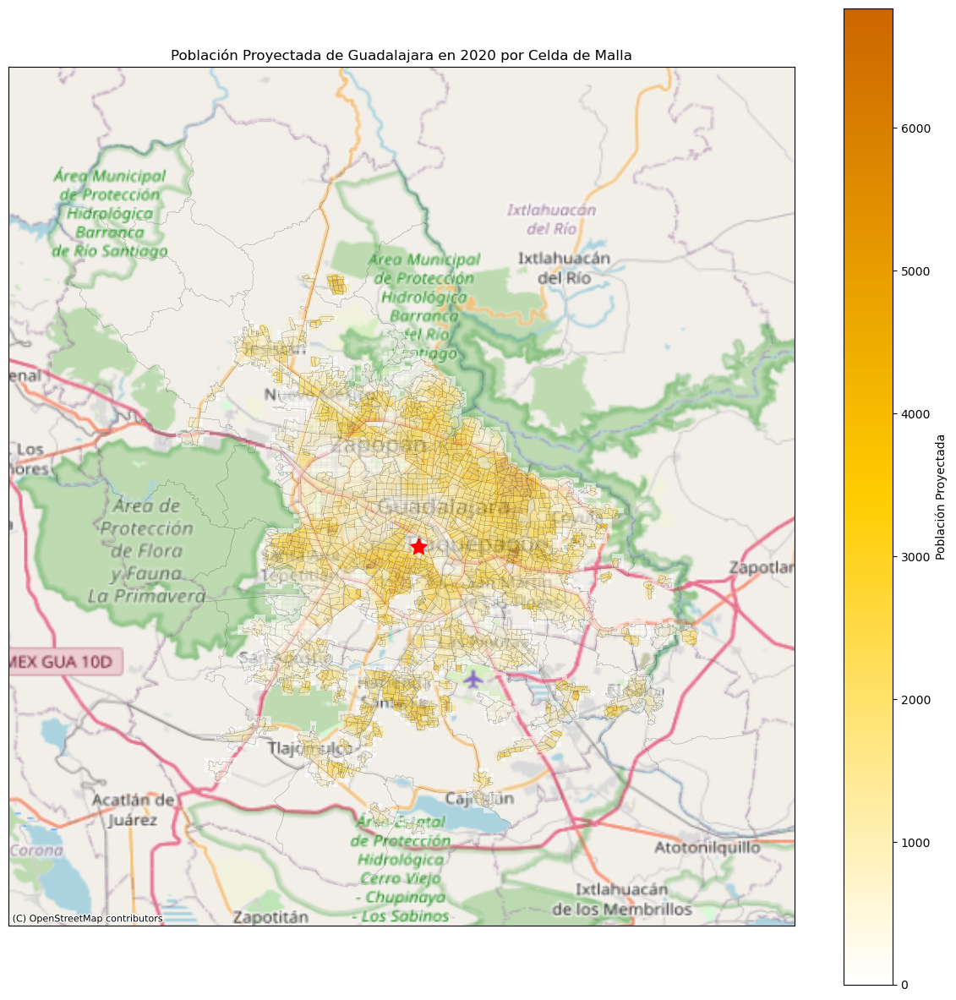

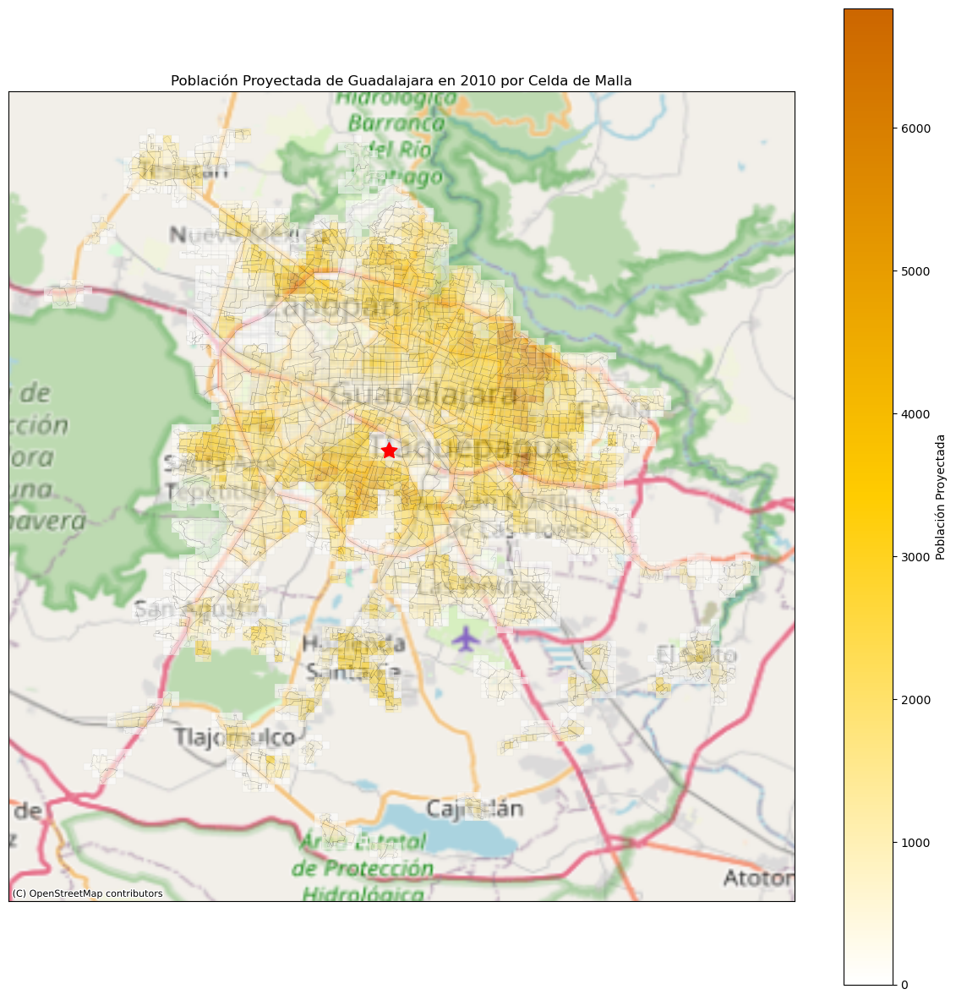

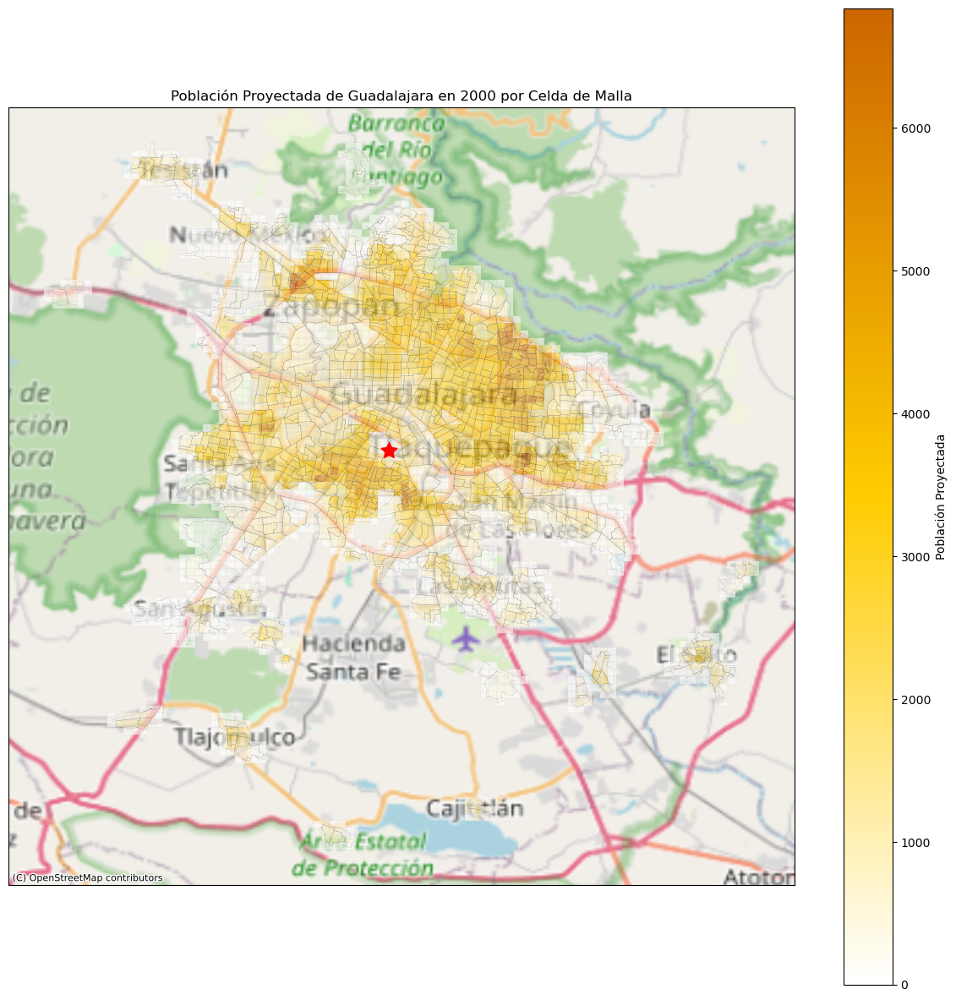

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

-30100.0
EPSG:6365


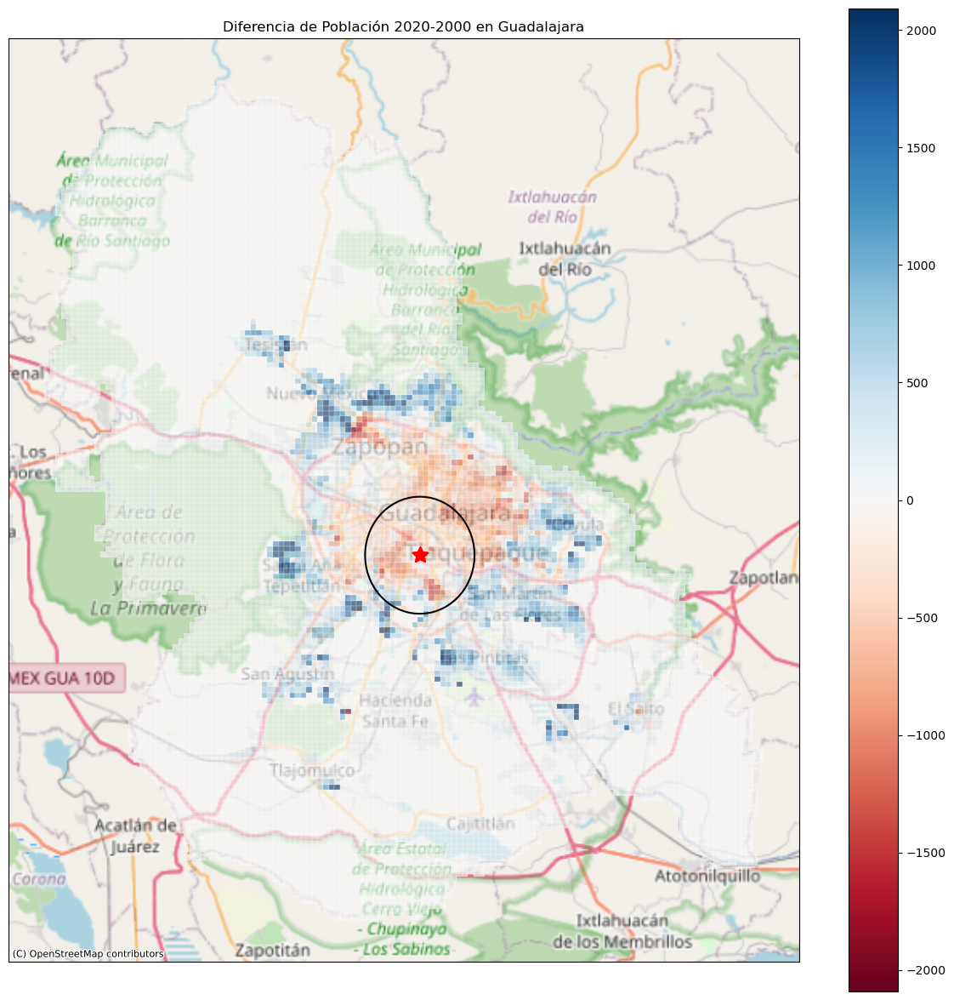

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 8.330661194125568
Porcentaje de valores negativos en diferencia_2020_2010: 3.289937792599243
Porcentaje de valores positivos en diferencia_2020_2000: 6.932597960623357
Porcentaje de valores negativos en diferencia_2020_2000: 3.0398255627525175
Población en 2020: 1246526.0
Población en 2020: 1246526.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

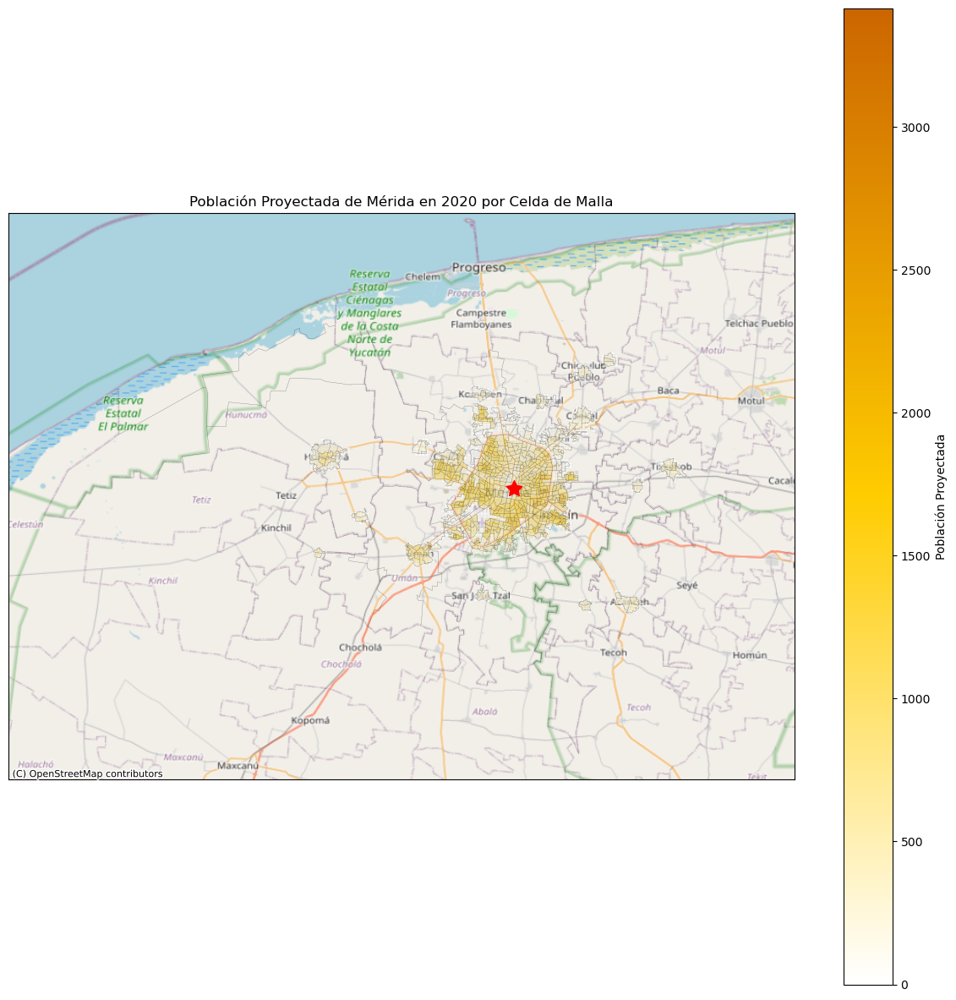

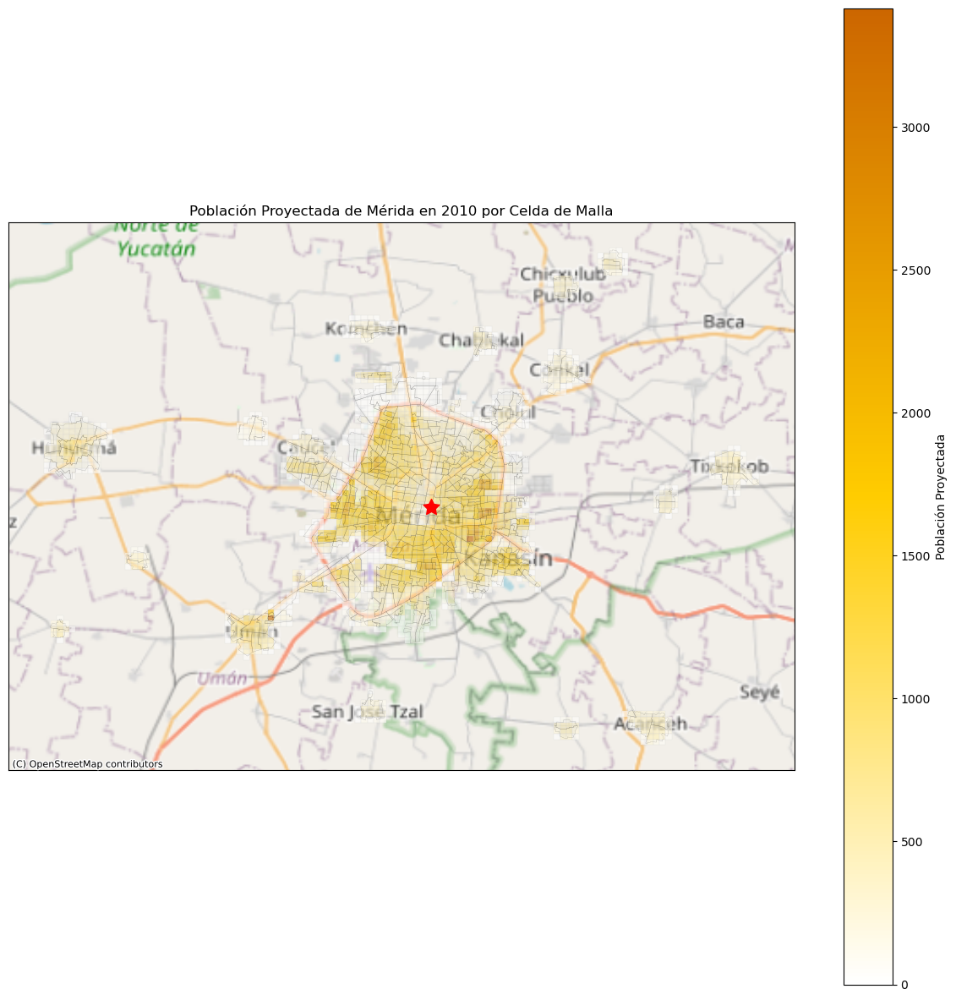

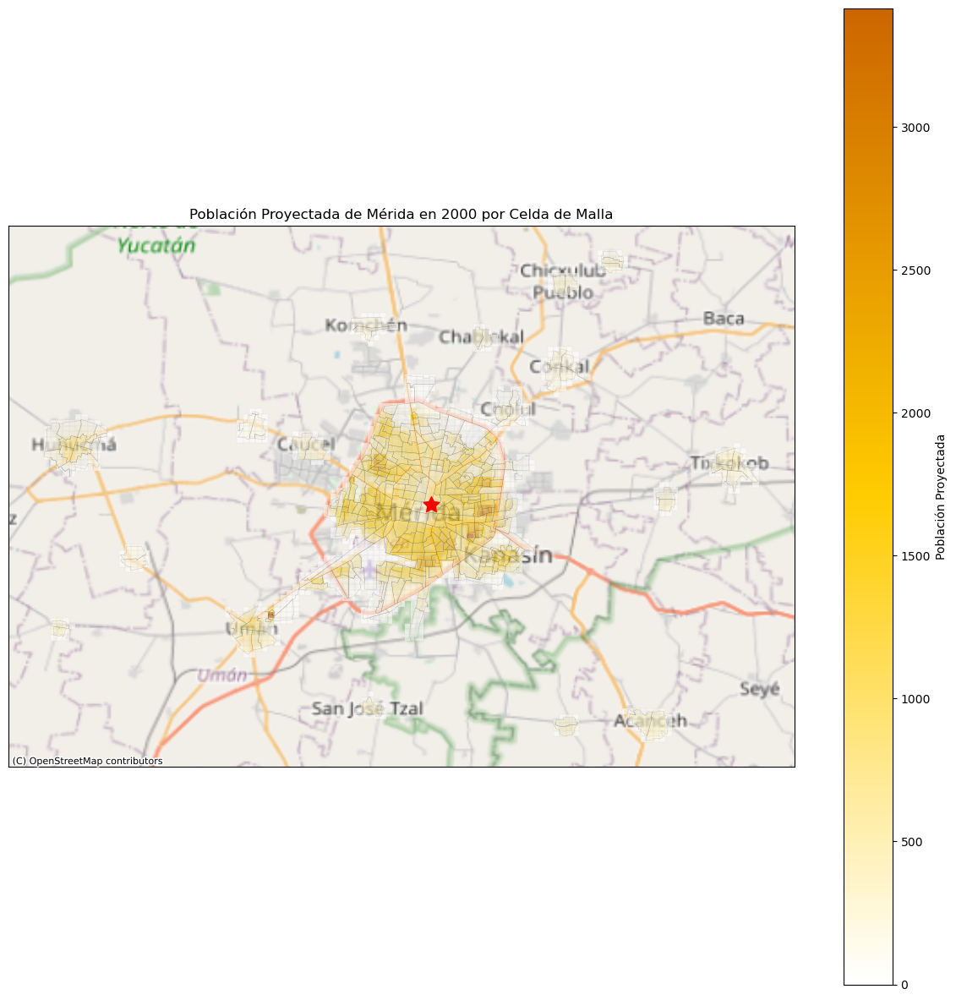

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

-26859.0
EPSG:6365


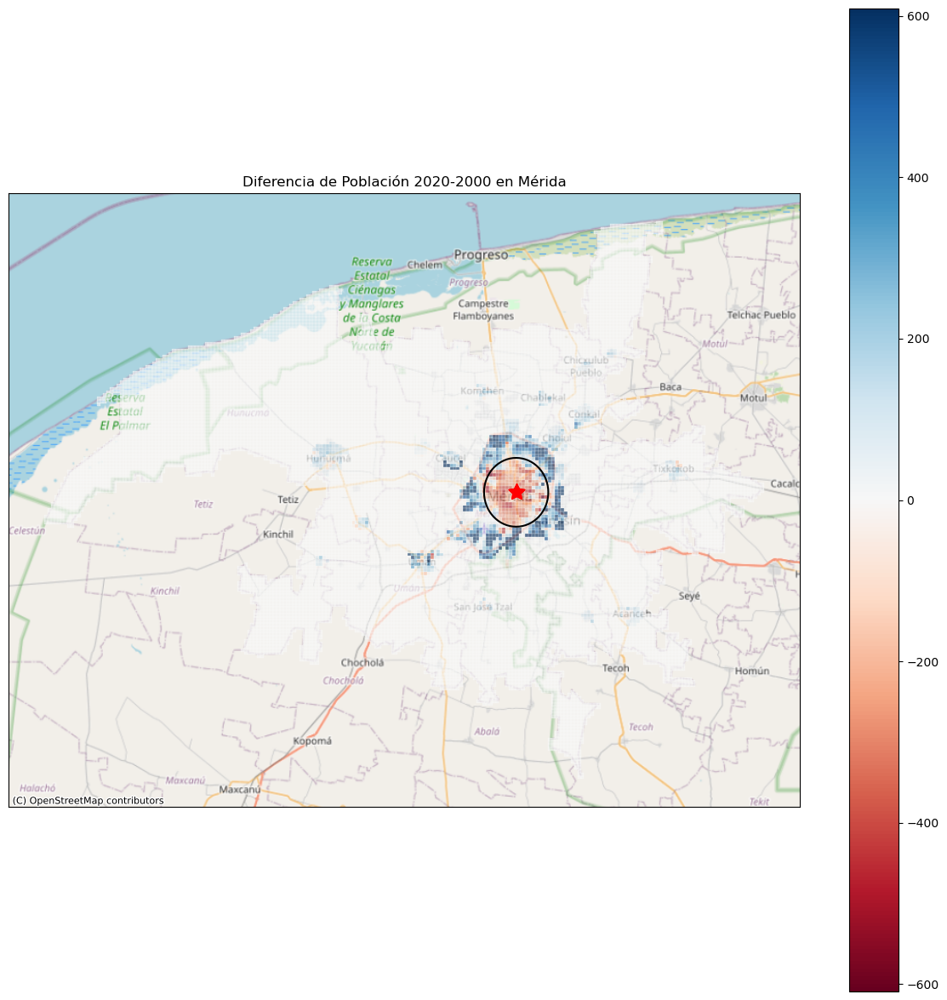

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 7.585651410982942
Porcentaje de valores negativos en diferencia_2020_2010: 5.117509996260392
Porcentaje de valores positivos en diferencia_2020_2000: 6.127204211374162
Porcentaje de valores negativos en diferencia_2020_2000: 4.634237551419613
Población en 2020: 5245560.0
Población en 2020: 5245560.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

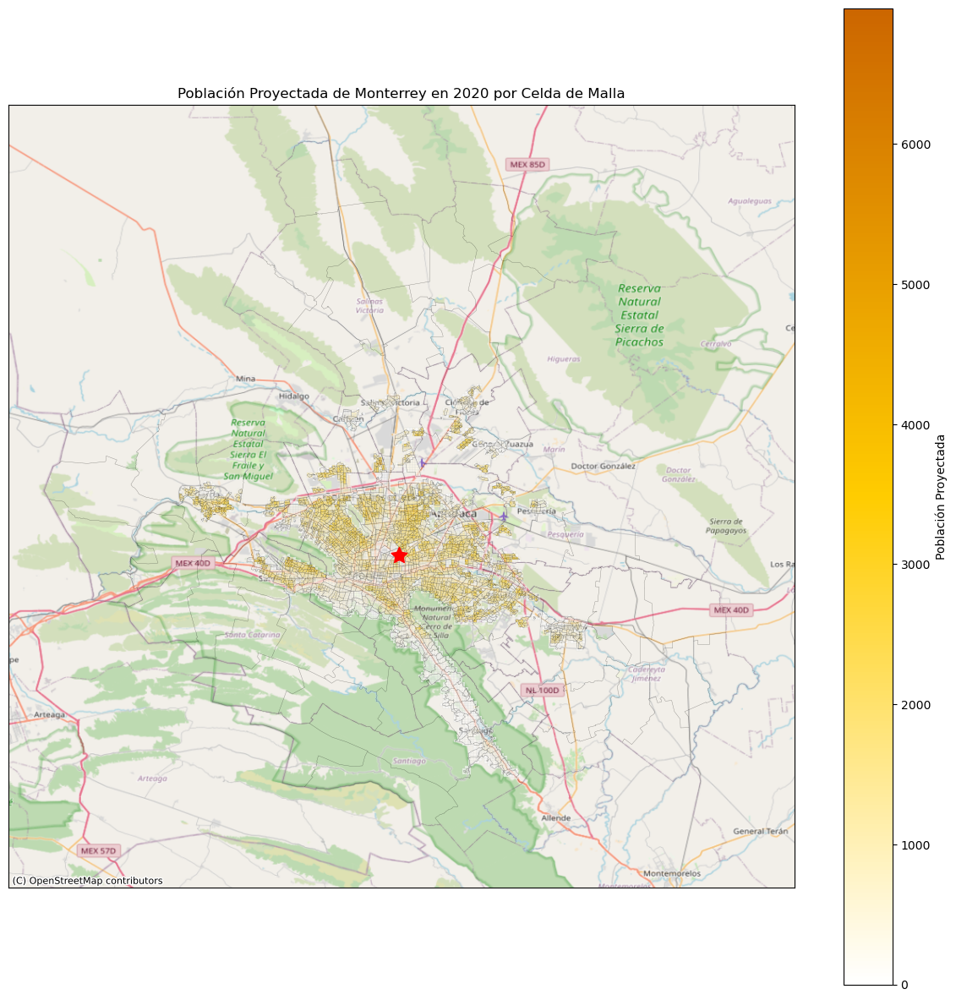

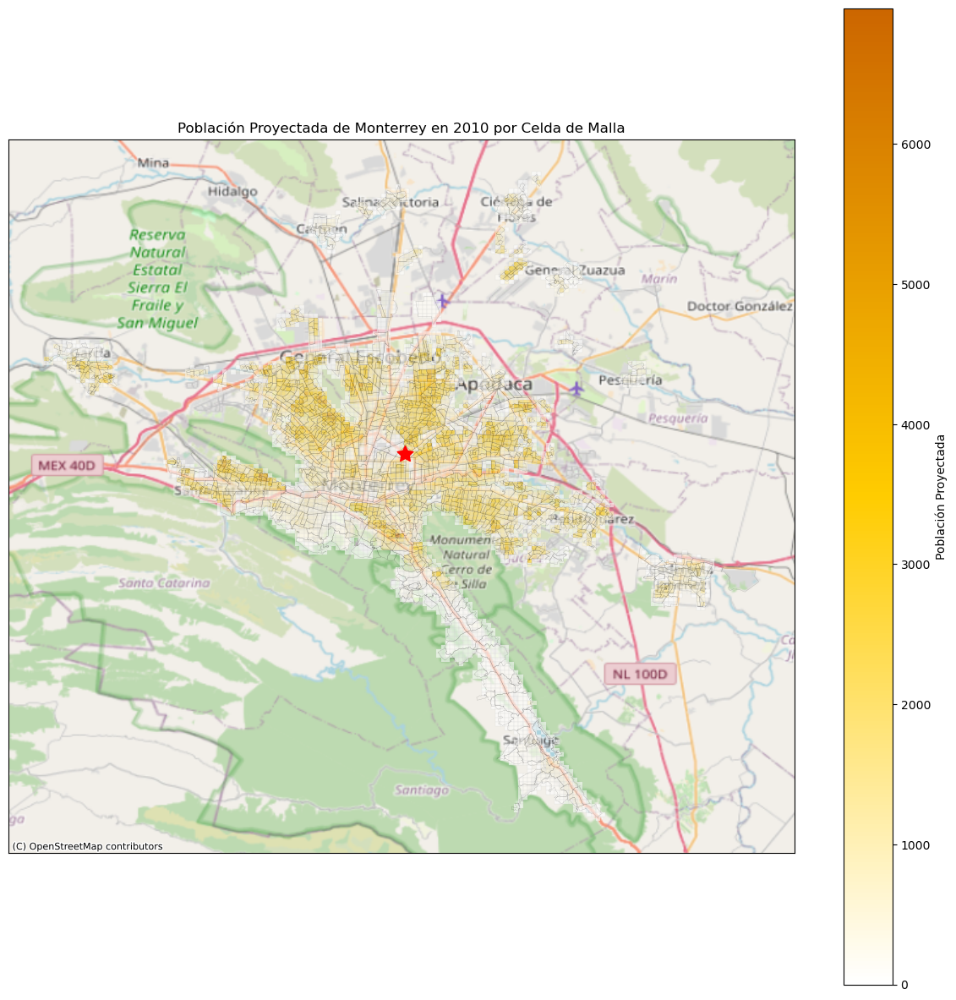

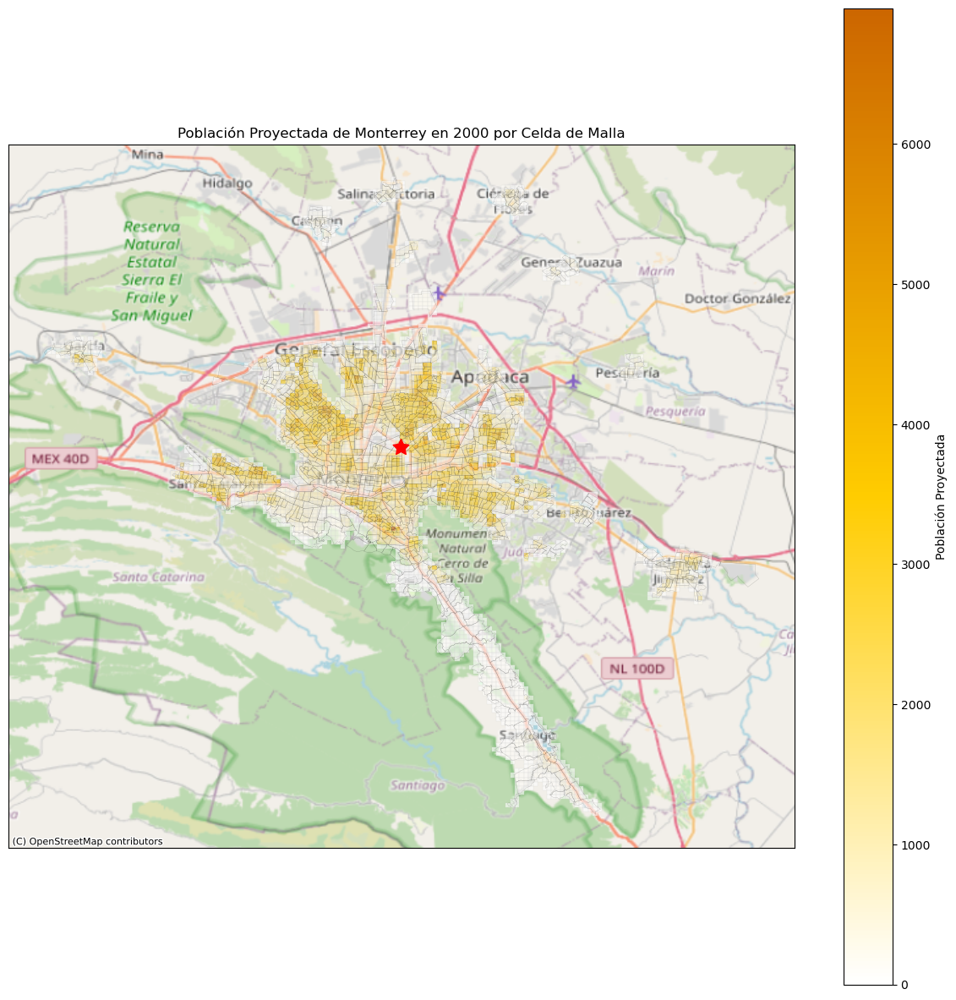

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

-39259.0
EPSG:6365


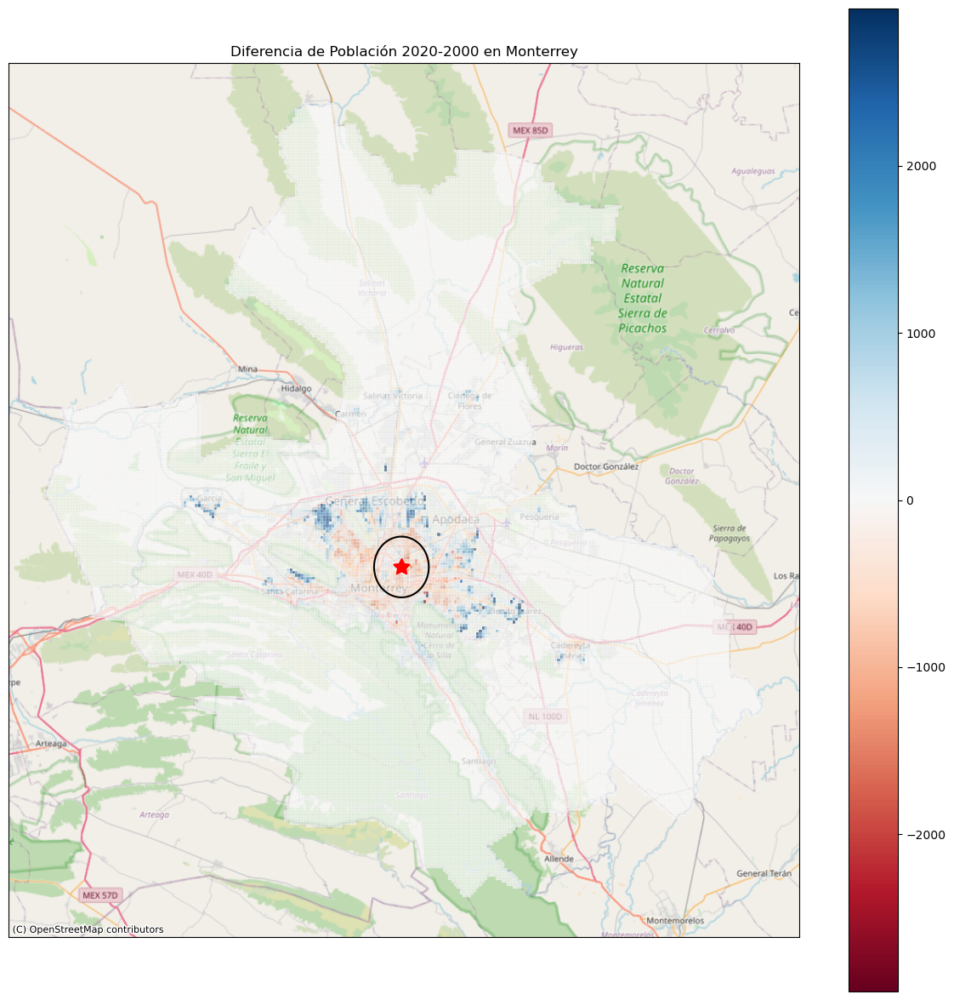

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 8.751661384316533
Porcentaje de valores negativos en diferencia_2020_2010: 2.9547081075554646
Porcentaje de valores positivos en diferencia_2020_2000: 5.888968408138227
Porcentaje de valores negativos en diferencia_2020_2000: 3.670381351600041
Población en 2020: 1381392.0
Población en 2020: 1381392.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

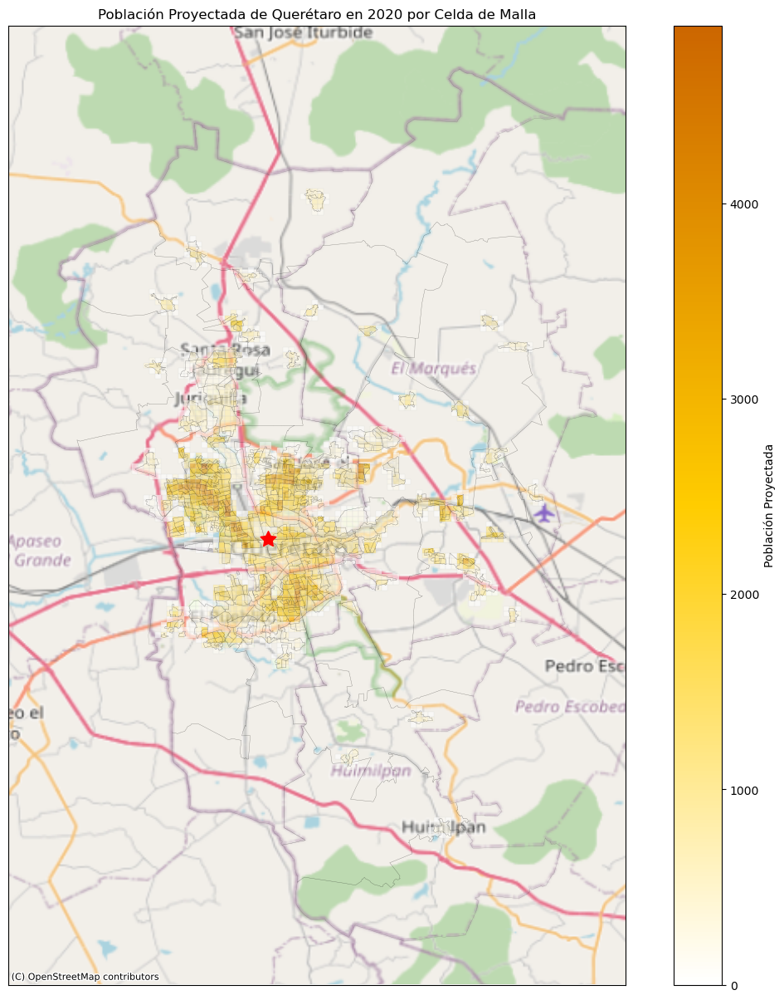

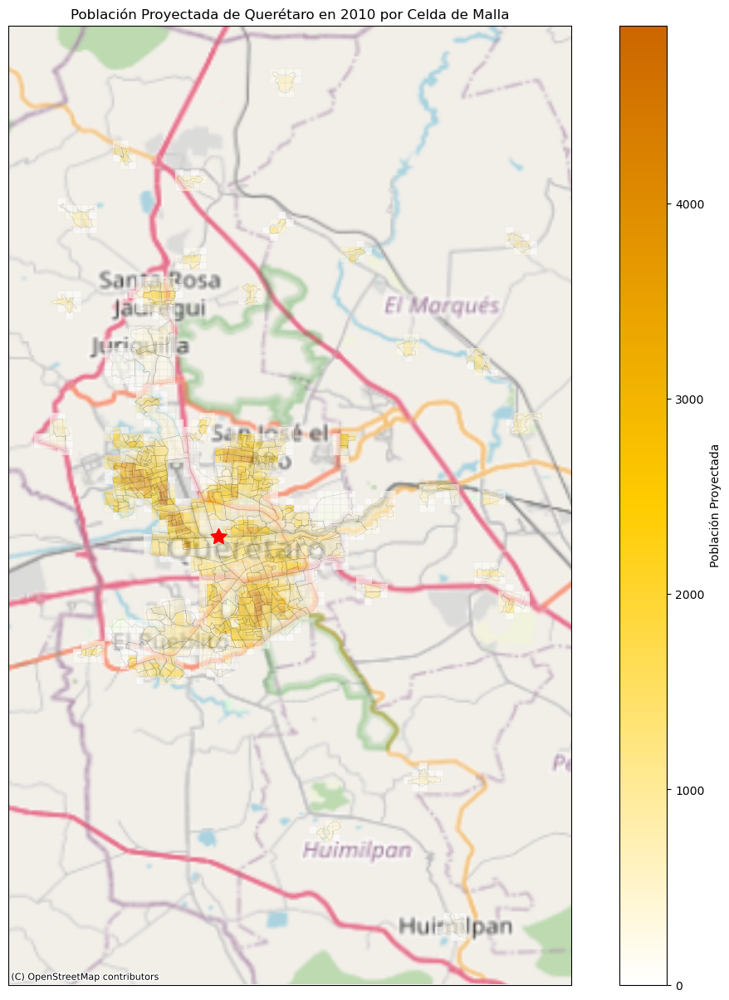

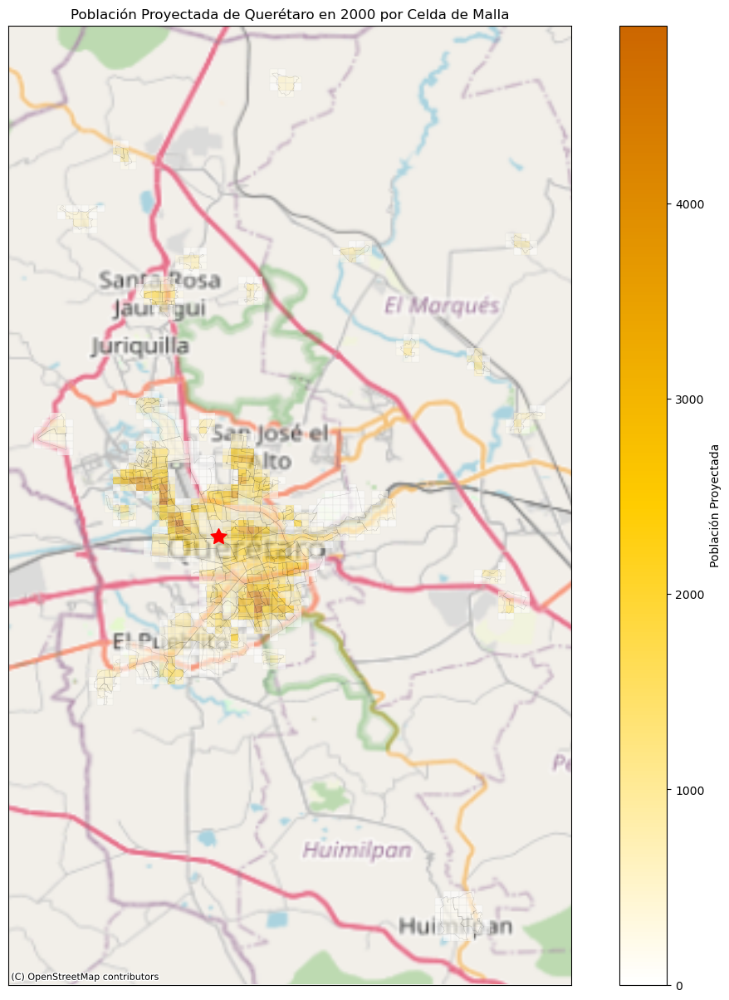

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

23223.0
EPSG:6365


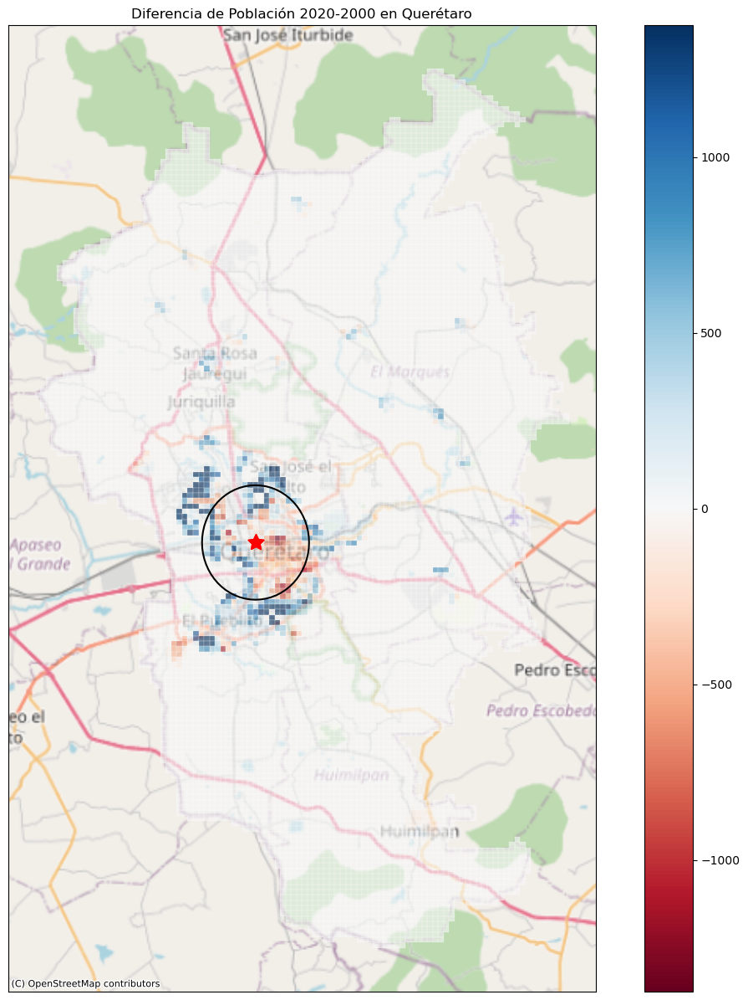

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 2.00222844987676
Porcentaje de valores negativos en diferencia_2020_2010: 1.1682479656953777
Porcentaje de valores positivos en diferencia_2020_2000: 1.3033055339838606
Porcentaje de valores negativos en diferencia_2020_2000: 1.1952594793530744
Población en 2020: 886283.0
Población en 2020: 886283.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

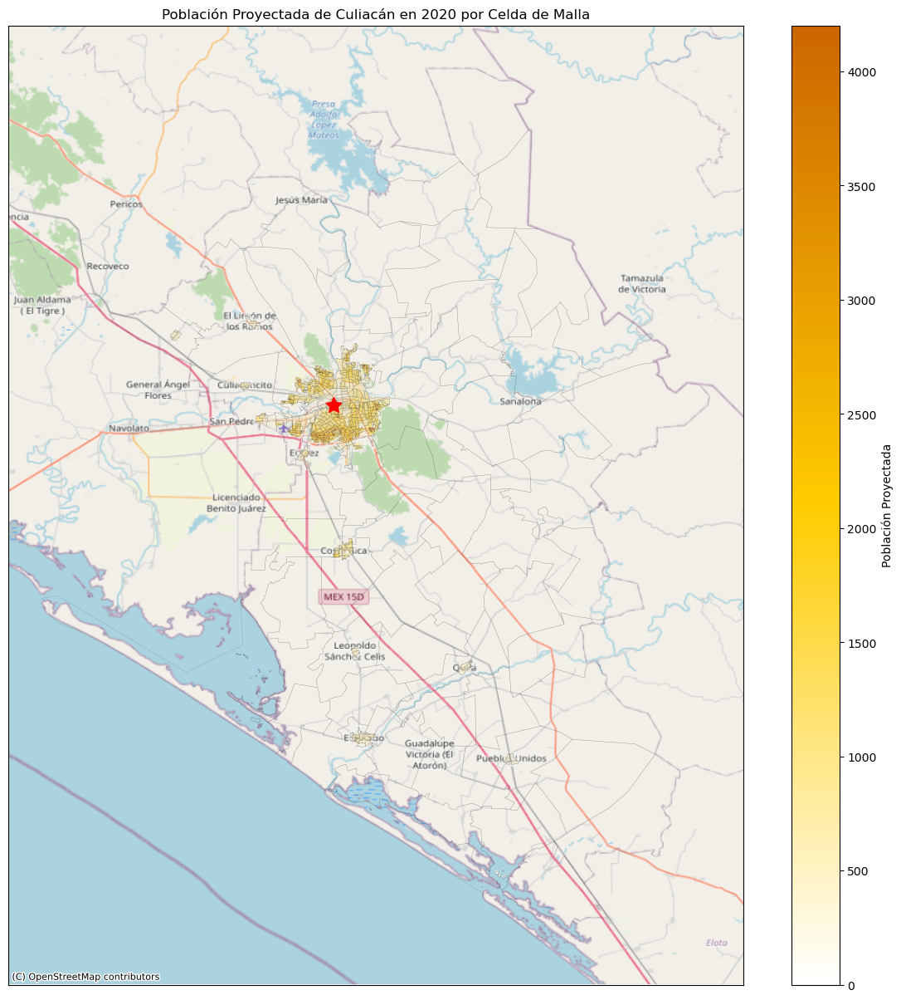

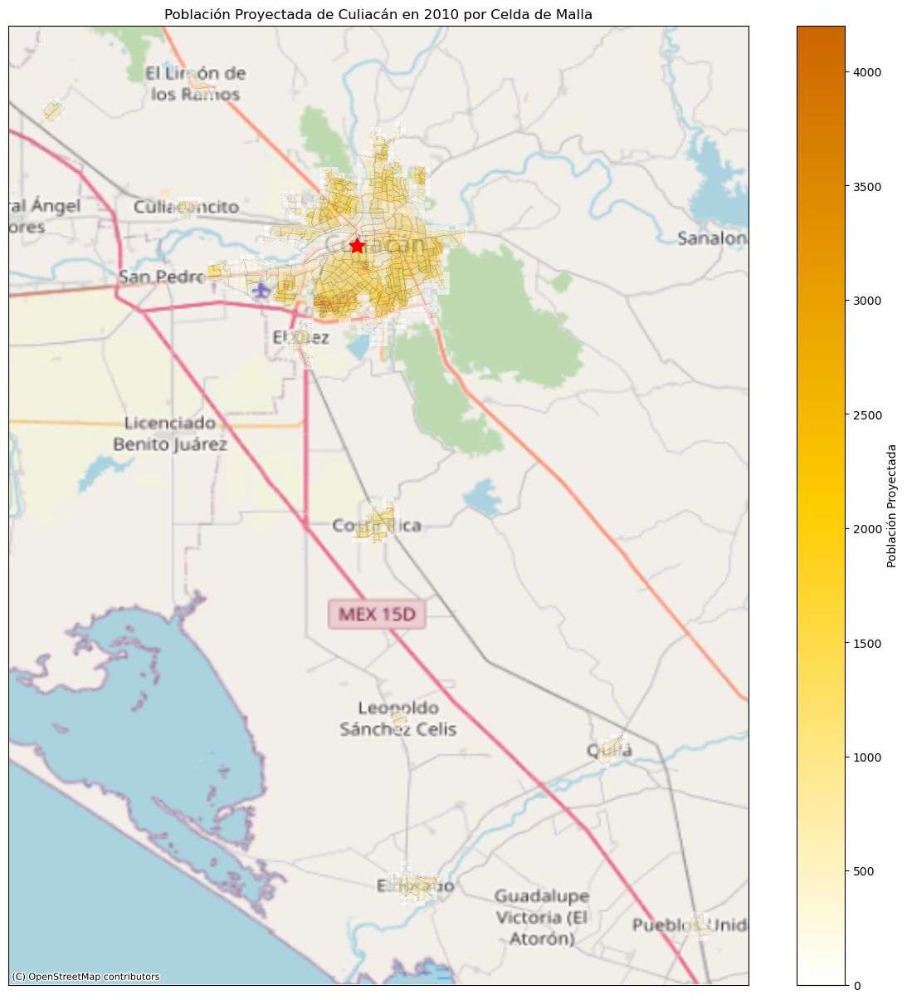

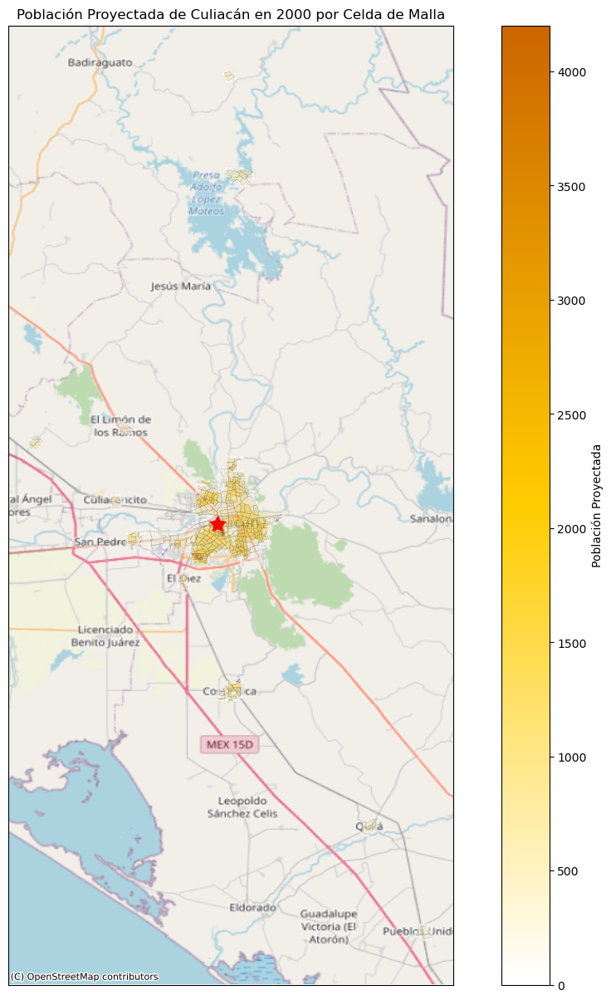

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

10053.0
EPSG:6365


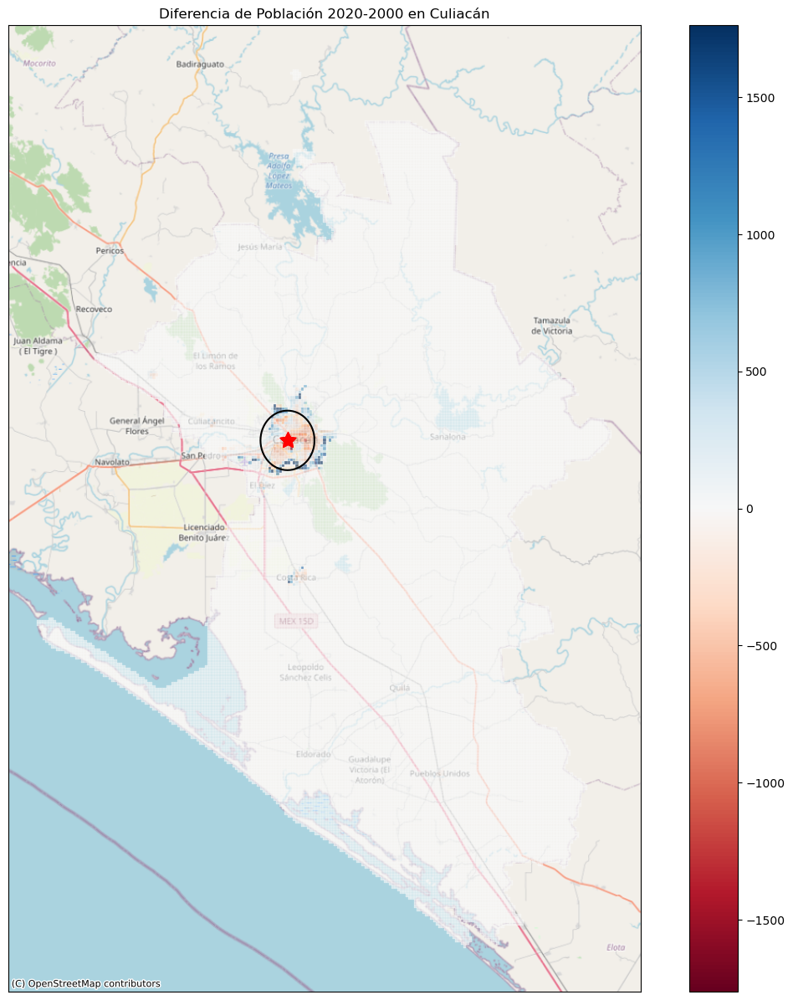

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 2.619401751776566
Porcentaje de valores negativos en diferencia_2020_2010: 1.5286729466203934
Porcentaje de valores positivos en diferencia_2020_2000: 2.214509998347381
Porcentaje de valores negativos en diferencia_2020_2000: 1.412989588497769
Población en 2020: 473913.0
Población en 2020: 473913.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

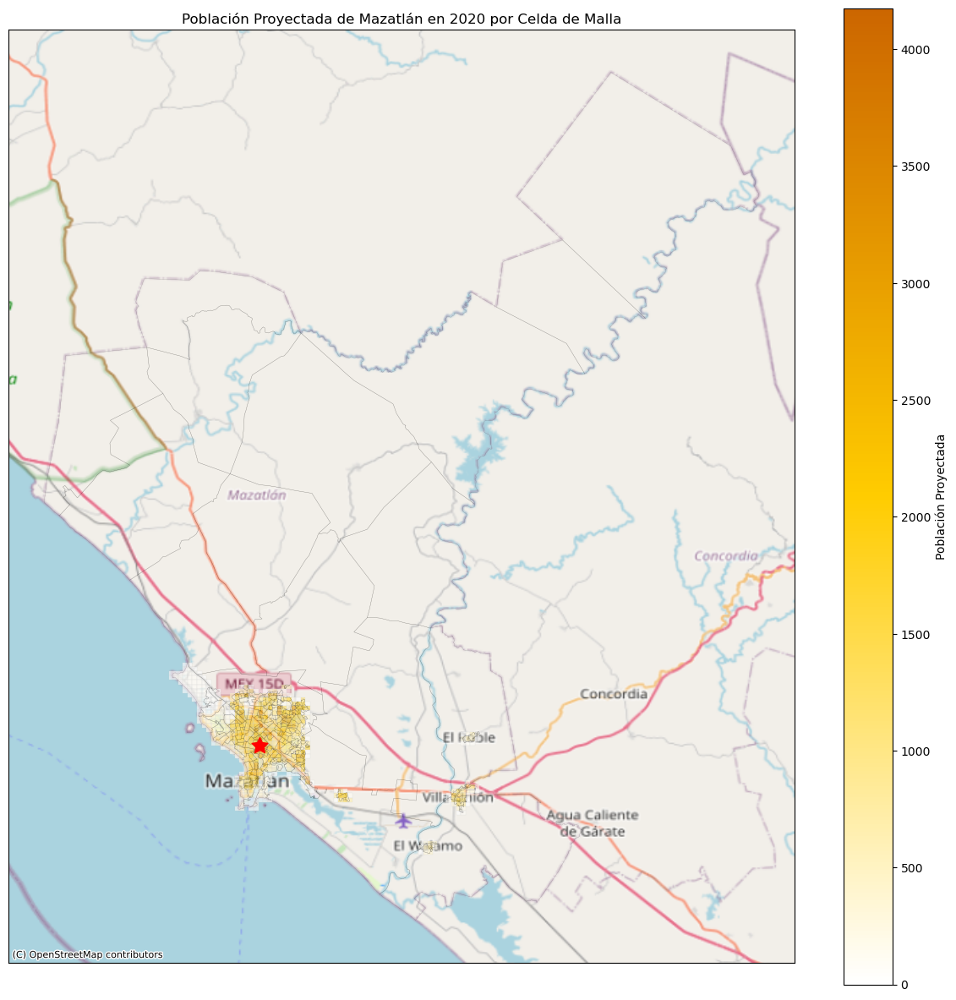

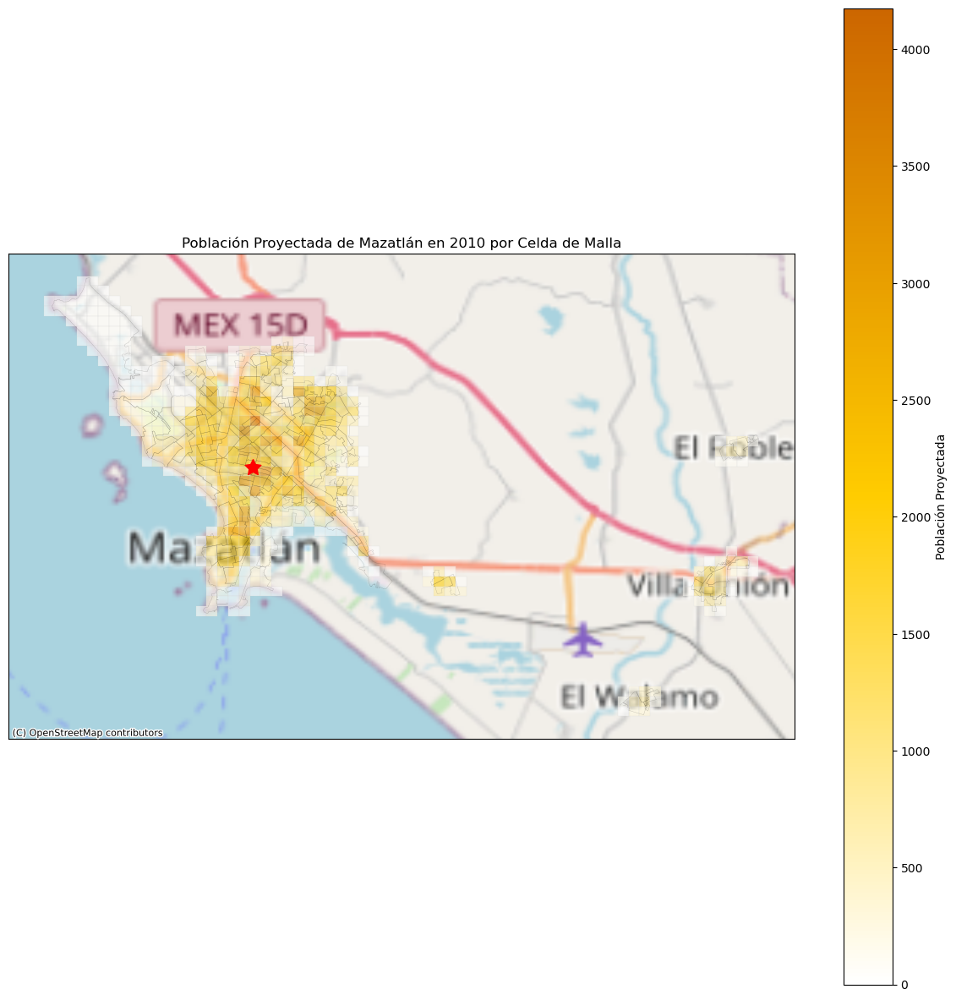

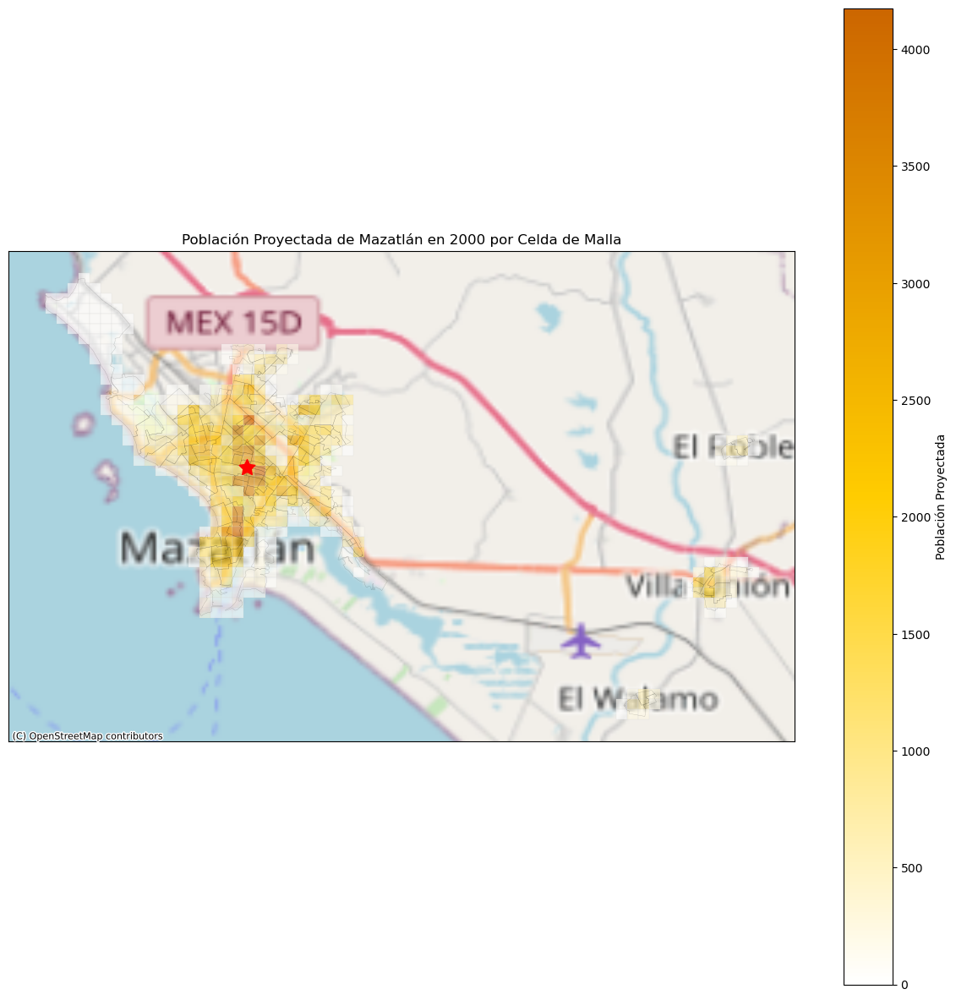

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

20647.0
EPSG:6365


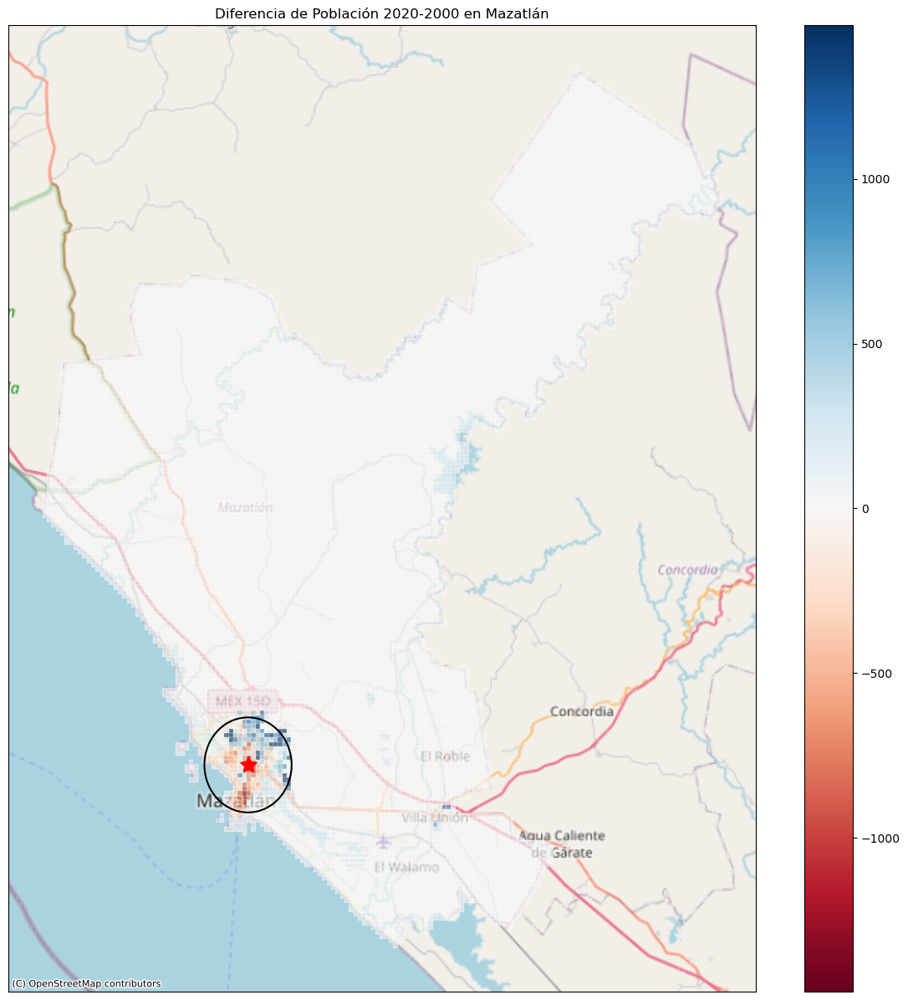

¡Gráficos de diferencia de población guardados!
¡Censo 2000 cargado!
¡Censo 2010 cargado!
¡Censo 2020 cargado!
¡Censo 2000 reproyectado!
¡Censo 2010 reproyectado!
¡Censo 2020 reproyectado!


/var/folders/nk/_xd63xrx3wn4jgn4d0v2_5y80000gn/T/ipykernel_15302/167809421.py:31: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')


¡Reproyecciones guardadas!
Porcentaje de valores positivos en diferencia_2020_2010: 0.7583456125196891
Porcentaje de valores negativos en diferencia_2020_2010: 0.5335094761445048
Porcentaje de valores positivos en diferencia_2020_2000: 0.5081042629947665
Porcentaje de valores negativos en diferencia_2020_2000: 0.4433209694629338
Población en 2020: 904857.0
Población en 2020: 904857.0


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:212: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:219: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(buffer_

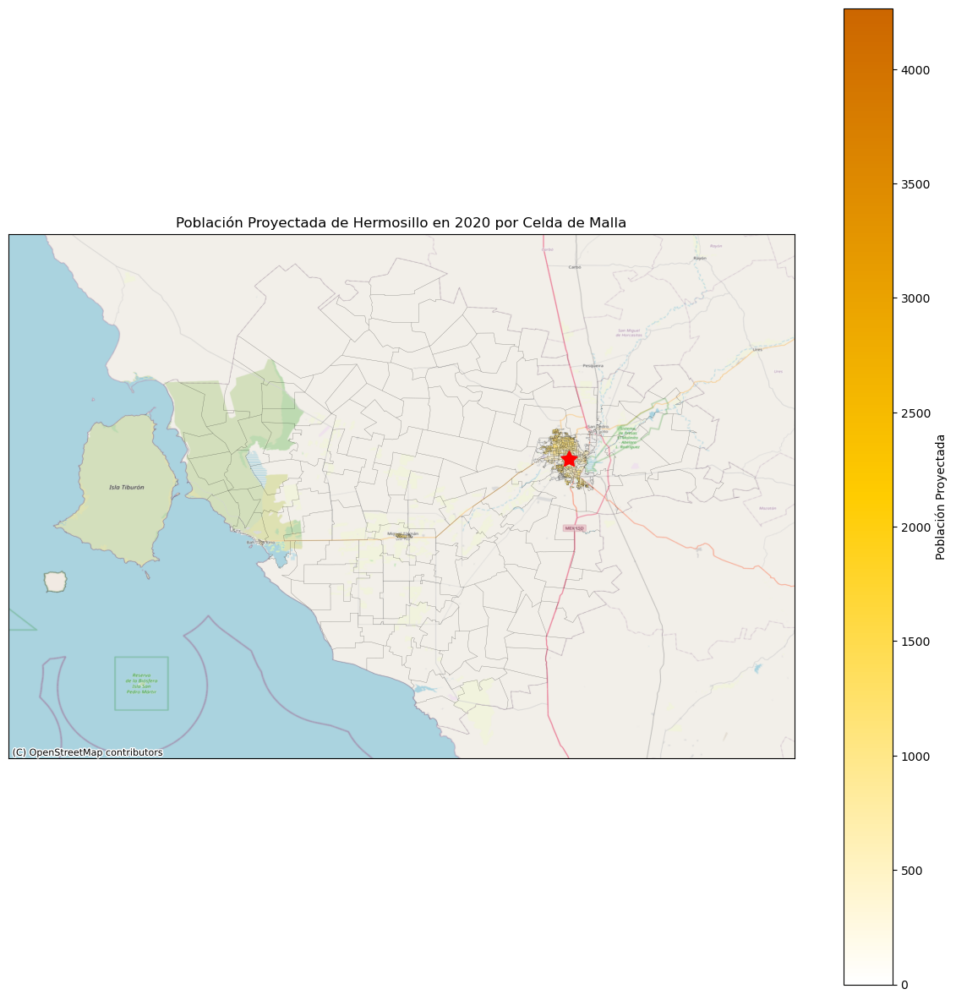

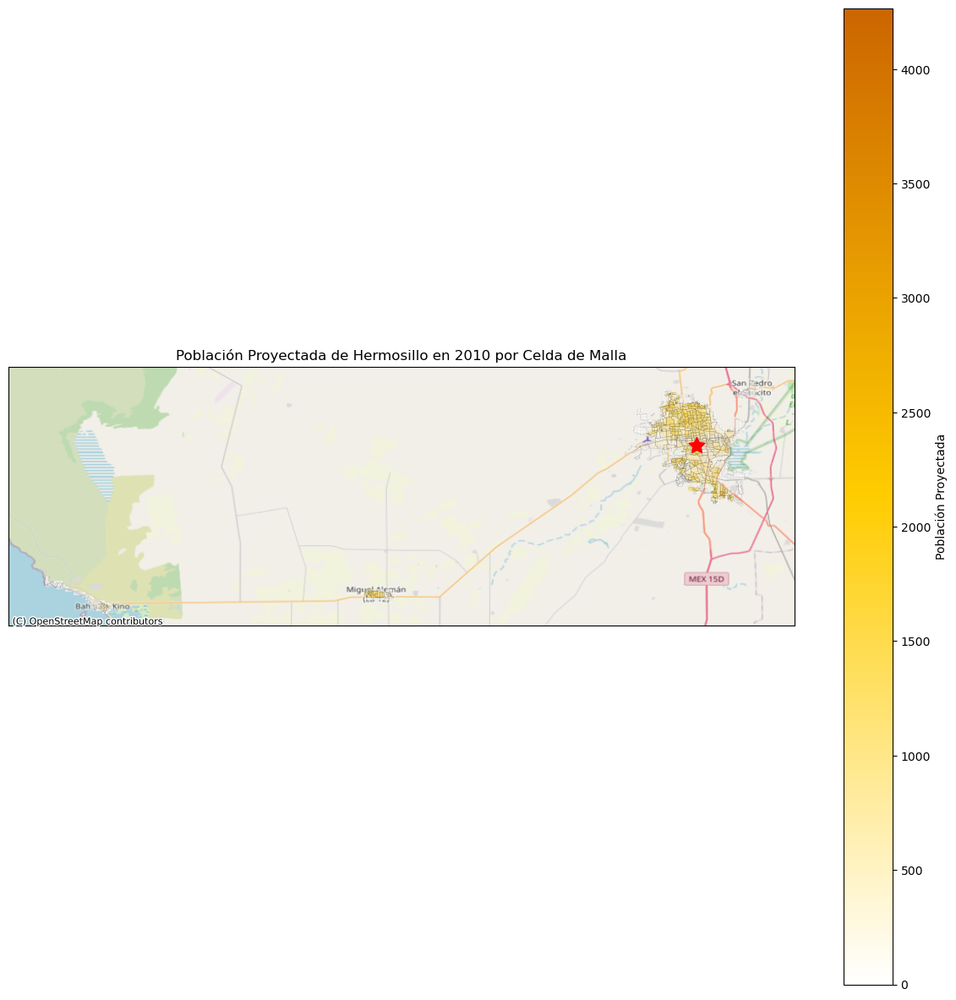

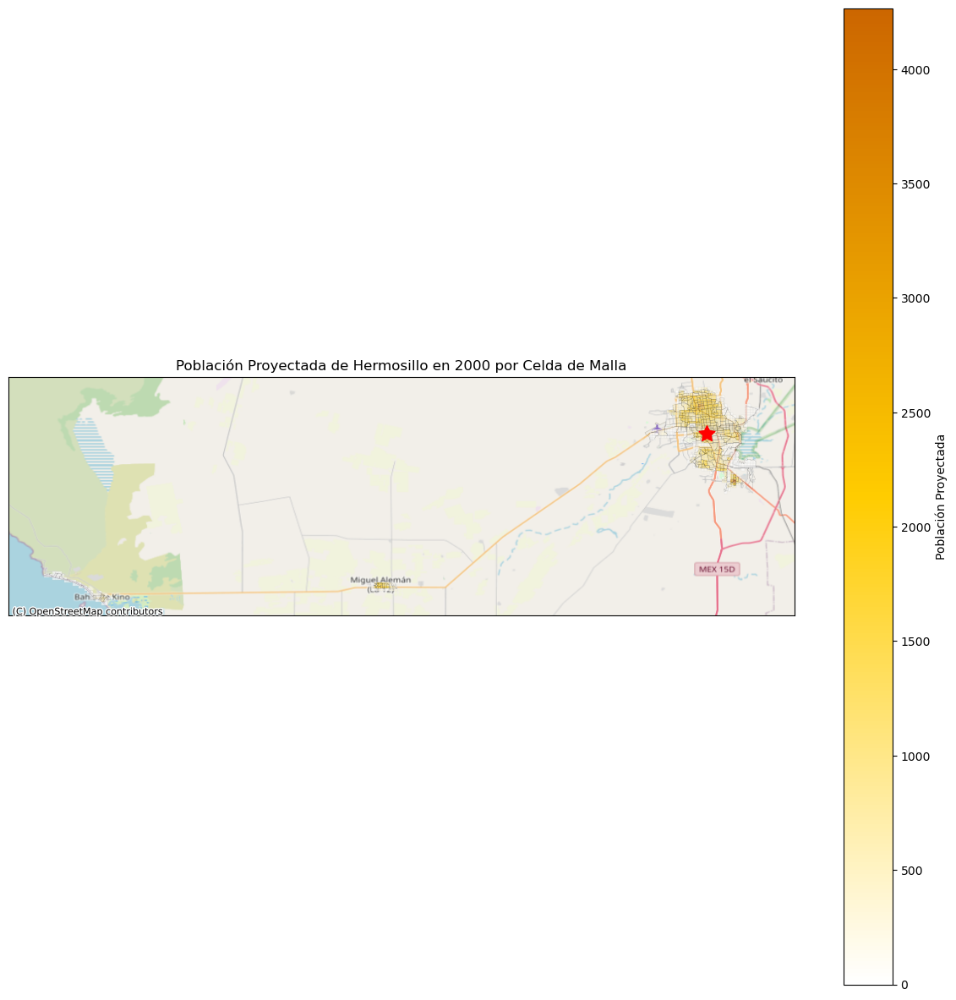

¡Gráficos de población guardados!


/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:301: DtypeWarning: Columns (9,10,13,14,15,16,17,18,19,26,27,28,29,30,31,32,33,34,35,36,45,46,47,53,54,55,56,57,58,59,63,67,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,123,124,125,126,127,128,129,130,153,154,155,156,157,159) have mixed types. Specify dtype option on import or set low_memory=False.
  ghsl_metro = pd.read_csv(path_data_raw+'GHS_STAT_UCDB2015MT_GLOBE_R2019A/GHS_STAT_UCDB2015MT_GLOBE_R2019A_V1_3.csv')
/Users/l03532466/Documents/TecMty/Reproyección Histórica de AGEBs/Code/DataProcessing/reprojection_source.py:305: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_geometry = start_point.buffer(5 / 111

-760.0
EPSG:6365


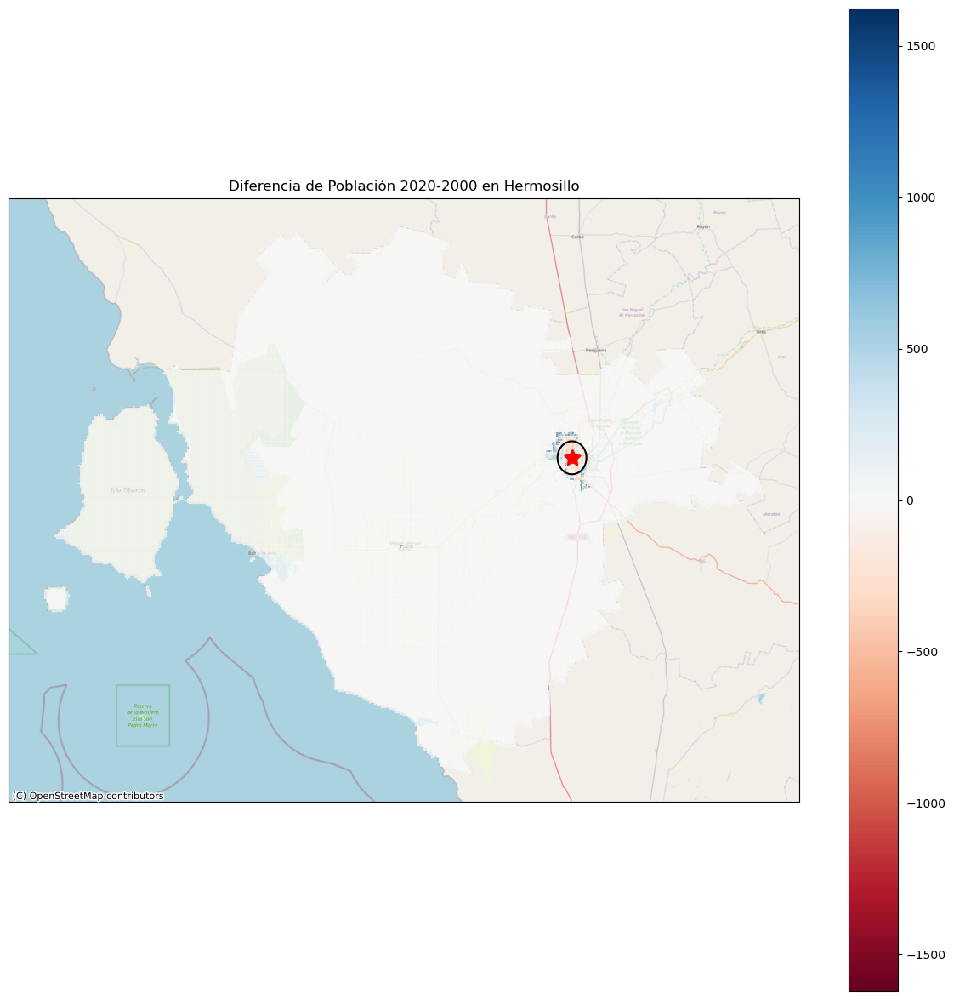

¡Gráficos de diferencia de población guardados!


In [13]:
for PLACE_NAME in [PLACE["NOM_MUN"] for PLACE in PLACES]:
    #if PLACE_NAME == "Culiacán" or PLACE_NAME == "Hermosillo":
    if True:
        #PLACE_NAME = "Mérida"
        place_2000 = gpd.read_file(path_data_processed + "censo_"+str(2000)+"_"+PLACE_NAME.lower()+".shp")
        print("¡Censo 2000 cargado!")
        place_2010 = gpd.read_file(path_data_processed + "censo_"+str(2010)+"_"+PLACE_NAME.lower()+".shp")
        print("¡Censo 2010 cargado!")
        place_2020 = gpd.read_file(path_data_processed + "censo_"+str(2020)+"_"+PLACE_NAME.lower()+".shp")
        print("¡Censo 2020 cargado!")
        
        place_2000_malla = rp.reproject_ageb_to_mesh(place_2000, malla_path, 9)
        print("¡Censo 2000 reproyectado!")
        place_2010_malla = rp.reproject_ageb_to_mesh(place_2010, malla_path, 9)
        print("¡Censo 2010 reproyectado!")
        place_2020_malla = rp.reproject_ageb_to_mesh(place_2020, malla_path, 9)
        print("¡Censo 2020 reproyectado!")
    
        result_df = pd.merge(place_2000_malla, place_2010_malla, on='codigo', how='outer', suffixes=('_2000', '_2010'))
        result_df = pd.merge(result_df, place_2020_malla, on='codigo', how='outer').rename(columns = {"poblacion_proyectada": "poblacion_proyectada_2020", 
                                                                                                    "geometry": "geometry_2020"})
        
        #result_df[['poblacion_proyectada_2000', 'poblacion_proyectada_2010', 'poblacion_proyectada_2020']] = result_df[['poblacion_proyectada_2000', 'poblacion_proyectada_2010', 'poblacion_proyectada_2020']].fillna(0, axis=1)
        result_df[['poblacion_proyectada_2000', 'poblacion_proyectada_2010', 'poblacion_proyectada_2020']] = result_df[['poblacion_proyectada_2000', 'poblacion_proyectada_2010', 'poblacion_proyectada_2020']]
        result_df['geometry'] = result_df['geometry_2000'].combine_first(result_df['geometry_2010']).combine_first(result_df['geometry_2020'])
        result_df = result_df[['codigo', 'poblacion_proyectada_2000', 'poblacion_proyectada_2010', 'poblacion_proyectada_2020', 'geometry']]
        
        result_df["diferencia_2020_2010"] = result_df["poblacion_proyectada_2020"] -  result_df["poblacion_proyectada_2010"]
        result_df["diferencia_2020_2000"] = result_df["poblacion_proyectada_2020"] -  result_df["poblacion_proyectada_2000"]
        result_df.fillna(0, inplace = True)
        result_df.to_file(path_data_modeling+"censo_reproyectado_"+PLACE_NAME.lower()+".shp", driver='ESRI Shapefile')
        print("¡Reproyecciones guardadas!")
    
        # Filtrar valores positivos y negativos y contar no nulos
        count_positive_2010_2020 = result_df['diferencia_2020_2010'][result_df['diferencia_2020_2010'] > 0].count()
        count_negative_2010_2020 = result_df['diferencia_2020_2010'][result_df['diferencia_2020_2010'] < 0].count()
        
        count_positive_2000_2020 = result_df['diferencia_2020_2000'][result_df['diferencia_2020_2000'] > 0].count()
        count_negative_2000_2020 = result_df['diferencia_2020_2000'][result_df['diferencia_2020_2000'] < 0].count()
        
        # Calcular porcentajes
        total_non_null_2010_2020 = result_df['diferencia_2020_2010'].count()
        percentage_positive_2010_2020 = (count_positive_2010_2020 / total_non_null_2010_2020) * 100
        percentage_negative_2010_2020 = (count_negative_2010_2020 / total_non_null_2010_2020) * 100
        
        total_non_null_2000_2020 = result_df['diferencia_2020_2000'].count()
        percentage_positive_2000_2020 = (count_positive_2000_2020 / total_non_null_2000_2020) * 100
        percentage_negative_2000_2020 = (count_negative_2000_2020 / total_non_null_2000_2020) * 100
        
        # Imprimir resultados
        print("Porcentaje de valores positivos en diferencia_2020_2010:", percentage_positive_2010_2020)
        print("Porcentaje de valores negativos en diferencia_2020_2010:", percentage_negative_2010_2020)
        
        print("Porcentaje de valores positivos en diferencia_2020_2000:", percentage_positive_2000_2020)
        print("Porcentaje de valores negativos en diferencia_2020_2000:", percentage_negative_2000_2020)
    
        print("Población en 2020:", result_df["poblacion_proyectada_2020"].sum())
        print("Población en 2020:", place_2020["POBTOT"].sum())
        rp.make_plots_pob(place_2000, place_2010, place_2020, result_df, PLACE_NAME, path_data_modeling,path_data_raw)
        print("¡Gráficos de población guardados!")
        rp.make_plots_dif(place_2020, result_df, PLACE_NAME, mpios_en_metropoli[mpios_en_metropoli.NOMGEO_COR == PLACE_NAME],path_data_modeling,path_data_raw)
        print("¡Gráficos de diferencia de población guardados!")

In [13]:
place_2020

,CVEGEO,POBTOT,geometry,ageb_area
0,1403900012696,6406.0,"POLYGON ((2357150.791 959790.056, 2357114.481 ...",5.189151e+05
1,1403900014207,4817.0,"POLYGON ((2367389.408 966302.223, 2367366.228 ...",1.696606e+05
2,1403900013020,4278.0,"POLYGON ((2363811.145 968828.465, 2363848.423 ...",8.637581e+05
3,1403900014194,3732.0,"POLYGON ((2367420.611 966341.257, 2367273.896 ...",1.939398e+05
4,1403900015243,3622.0,"POLYGON ((2368089.648 964164.191, 2368052.176 ...",1.444307e+05
...,...,...,...,...
1998,141200091,NaN,"POLYGON ((2329608.300 983855.630, 2329621.000 ...",7.319398e+07
1999,141200104,NaN,"POLYGON ((2344864.233 982878.188, 2344855.590 ...",6.511481e+07
2000,141200157,NaN,"POLYGON ((2344704.630 969239.247, 2344583.697 ...",3.554613e+07
2001,141200585,NaN,"POLYGON ((2342541.349 961566.631, 2342640.342 ...",6.968735e+07


In [31]:
# Filtrar valores positivos y negativos y contar no nulos
count_positive_2010_2020 = result_df['diferencia_2020_2010'][result_df['diferencia_2020_2010'] > 0].count()
count_negative_2010_2020 = result_df['diferencia_2020_2010'][result_df['diferencia_2020_2010'] < 0].count()

count_positive_2000_2020 = result_df['diferencia_2020_2000'][result_df['diferencia_2020_2000'] > 0].count()
count_negative_2000_2020 = result_df['diferencia_2020_2000'][result_df['diferencia_2020_2000'] < 0].count()

# Calcular porcentajes
total_non_null_2010_2020 = result_df['diferencia_2020_2010'].count()
percentage_positive_2010_2020 = (count_positive_2010_2020 / total_non_null_2010_2020) * 100
percentage_negative_2010_2020 = (count_negative_2010_2020 / total_non_null_2010_2020) * 100

total_non_null_2000_2020 = result_df['diferencia_2020_2000'].count()
percentage_positive_2000_2020 = (count_positive_2000_2020 / total_non_null_2000_2020) * 100
percentage_negative_2000_2020 = (count_negative_2000_2020 / total_non_null_2000_2020) * 100

# Imprimir resultados
print("Porcentaje de valores positivos en diferencia_2020_2010:", percentage_positive_2010_2020)
print("Porcentaje de valores negativos en diferencia_2020_2010:", percentage_negative_2010_2020)

print("Porcentaje de valores positivos en diferencia_2020_2000:", percentage_positive_2000_2020)
print("Porcentaje de valores negativos en diferencia_2020_2000:", percentage_negative_2000_2020)

Porcentaje de valores positivos en diferencia_2020_2010: 60.264227642276424
Porcentaje de valores negativos en diferencia_2020_2010: 35.16260162601626
Porcentaje de valores positivos en diferencia_2020_2000: 51.67336010709504
Porcentaje de valores negativos en diferencia_2020_2000: 47.389558232931726
